In [5]:
!pip install accelerate diffusers transformers einops torchsde

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 6.8 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.3.1 -> 23.3.2
[notice] To update, run: python -m pip install --upgrade pip


In [134]:
# Copyright 2023 The HuggingFace Team. All rights reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

import inspect
from typing import Any, Callable, Dict, List, Optional, Tuple, Union

import torch
import torch.nn as nn
import torch.nn.functional as F
from transformers import (
    CLIPImageProcessor,
    CLIPTextModel,
    CLIPTextModelWithProjection,
    CLIPTokenizer,
    CLIPVisionModelWithProjection,
)
from PIL import Image

from diffusers.image_processor import PipelineImageInput, VaeImageProcessor
from diffusers.loaders import (
    FromSingleFileMixin,
    IPAdapterMixin,
    StableDiffusionXLLoraLoaderMixin,
    TextualInversionLoaderMixin,
)
from diffusers.models import AutoencoderKL, ImageProjection, UNet2DConditionModel
from diffusers.models.attention_processor import (
    Attention,
    AttnProcessor2_0,
    FusedAttnProcessor2_0,
    LoRAAttnProcessor2_0,
    LoRAXFormersAttnProcessor,
    XFormersAttnProcessor,
)
from diffusers.models.lora import adjust_lora_scale_text_encoder
from diffusers.pipelines.pipeline_utils import DiffusionPipeline
from diffusers.pipelines.stable_diffusion_xl.pipeline_output import StableDiffusionXLPipelineOutput
from diffusers.schedulers import KarrasDiffusionSchedulers
from diffusers.utils import (
    USE_PEFT_BACKEND,
    deprecate,
    is_invisible_watermark_available,
    is_torch_xla_available,
    logging,
    replace_example_docstring,
    scale_lora_layers,
    unscale_lora_layers,
)
from diffusers.utils.torch_utils import randn_tensor


if is_invisible_watermark_available():
    from diffusers.pipelines.stable_diffusion_xl.watermark import StableDiffusionXLWatermarker

if is_torch_xla_available():
    import torch_xla.core.xla_model as xm

    XLA_AVAILABLE = True
else:
    XLA_AVAILABLE = False

try:
    import einops
except ModuleNotFoundError:
    print("Please install the required package `einops` using `pip install einops`")

logger = logging.get_logger(__name__)  # pylint: disable=invalid-name

EXAMPLE_DOC_STRING = """
    Examples:
        ```py
        >>> import torch
        >>> from diffusers import StableDiffusionXLPipeline

        >>> pipe = StableDiffusionXLPipeline.from_pretrained(
        ...     "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16
        ... )
        >>> pipe = pipe.to("cuda")

        >>> prompt = "a photo of an astronaut riding a horse on mars"
        >>> image = pipe(prompt).images[0]
        ```
"""


def expand_first(feat: torch.Tensor, scale: float = 1.0) -> torch.Tensor:
    b = feat.shape[0]
    feat_style = torch.stack((feat[0], feat[b // 2])).unsqueeze(1)
    if scale == 1:
        feat_style = feat_style.expand(2, b // 2, *feat.shape[1:])
    else:
        feat_style = feat_style.repeat(1, b // 2, 1, 1, 1)
        feat_style = torch.cat([feat_style[:, :1], scale * feat_style[:, 1:]], dim=1)
    return feat_style.reshape(*feat.shape)


def concat_first(feat: torch.Tensor, dim: int = 2, scale: float = 1.0) -> torch.Tensor:
    feat_style = expand_first(feat, scale=scale)
    return torch.cat((feat, feat_style), dim=dim)


def calc_mean_std(feat: torch.Tensor, eps: float = 1e-5) -> tuple[torch.Tensor, torch.Tensor]:
    feat_std = (feat.var(dim=-2, keepdims=True) + eps).sqrt()
    feat_mean = feat.mean(dim=-2, keepdims=True)
    return feat_mean, feat_std


def adain(feat: torch.Tensor) -> torch.Tensor:
    feat_mean, feat_std = calc_mean_std(feat)
    feat_style_mean = expand_first(feat_mean)
    feat_style_std = expand_first(feat_std)
    feat = (feat - feat_mean) / feat_std
    feat = feat * feat_style_std + feat_style_mean
    return feat


def get_switch_vec(total_num_layers, level):
    if level == 0:
        return torch.zeros(total_num_layers, dtype=torch.bool)
    if level == 1:
        return torch.ones(total_num_layers, dtype=torch.bool)
    to_flip = level > .5
    if to_flip:
        level = 1 - level
    num_switch = int(level * total_num_layers)
    vec = torch.arange(total_num_layers)
    vec = vec % (total_num_layers // num_switch)
    vec = vec == 0
    if to_flip:
        vec = ~vec
    return vec


class SharedAttentionProcessor(AttnProcessor2_0):
    def __init__(
        self,
        share_attention: bool = True,
        adain_queries: bool = True,
        adain_keys: bool = True,
        adain_values: bool = False,
        full_attention_share: bool = False,
        shared_score_scale: float = 1.0,
        shared_score_shift: float = 0.0,
    ):
        super().__init__()
        self.share_attention = share_attention
        self.adain_queries = adain_queries
        self.adain_keys = adain_keys
        self.adain_values = adain_values
        self.full_attention_share = full_attention_share
        self.shared_score_scale = shared_score_scale
        self.shared_score_shift = shared_score_shift

    def shared_call(
        self,
        attn: Attention,
        hidden_states: torch.Tensor,
        encoder_hidden_states: Optional[torch.Tensor] = None,
        attention_mask: Optional[torch.Tensor] = None,
        **kwargs
    ):
        residual = hidden_states
        input_ndim = hidden_states.ndim
        if input_ndim == 4:
            batch_size, channel, height, width = hidden_states.shape
            hidden_states = hidden_states.view(batch_size, channel, height * width).transpose(1, 2)
        batch_size, sequence_length, _ = (
            hidden_states.shape if encoder_hidden_states is None else encoder_hidden_states.shape
        )

        if attention_mask is not None:
            attention_mask = attn.prepare_attention_mask(attention_mask, sequence_length, batch_size)
            # scaled_dot_product_attention expects attention_mask shape to be
            # (batch, heads, source_length, target_length)
            attention_mask = attention_mask.view(batch_size, attn.heads, -1, attention_mask.shape[-1])

        if attn.group_norm is not None:
            hidden_states = attn.group_norm(hidden_states.transpose(1, 2)).transpose(1, 2)

        query = attn.to_q(hidden_states)
        key = attn.to_k(hidden_states)
        value = attn.to_v(hidden_states)
        inner_dim = key.shape[-1]
        head_dim = inner_dim // attn.heads

        query = query.view(batch_size, -1, attn.heads, head_dim).transpose(1, 2)
        key = key.view(batch_size, -1, attn.heads, head_dim).transpose(1, 2)
        value = value.view(batch_size, -1, attn.heads, head_dim).transpose(1, 2)
        
        if self.adain_queries:
            query = adain(query)
        if self.adain_keys:
            key = adain(key)
        if self.adain_values:
            value = adain(value)
        if self.share_attention:
            key = concat_first(key, -2, scale=self.shared_score_scale)
            value = concat_first(value, -2)
            if self.shared_score_shift != 0:
                hidden_states = self.shifted_scaled_dot_product_attention(attn, query, key, value,)
            else:
                hidden_states = F.scaled_dot_product_attention(
                    query, key, value, attn_mask=attention_mask, dropout_p=0.0, is_causal=False
                )
        else:
            hidden_states = F.scaled_dot_product_attention(
                query, key, value, attn_mask=attention_mask, dropout_p=0.0, is_causal=False
            )
        
        hidden_states = hidden_states.transpose(1, 2).reshape(batch_size, -1, attn.heads * head_dim)
        hidden_states = hidden_states.to(query.dtype)

        # linear proj
        hidden_states = attn.to_out[0](hidden_states)
        # dropout
        hidden_states = attn.to_out[1](hidden_states)

        if input_ndim == 4:
            hidden_states = hidden_states.transpose(-1, -2).reshape(batch_size, channel, height, width)

        if attn.residual_connection:
            hidden_states = hidden_states + residual

        hidden_states = hidden_states / attn.rescale_output_factor
        return hidden_states

    def __call__(self, attn: Attention, hidden_states: torch.Tensor, encoder_hidden_states: Optional[torch.Tensor] = None, attention_mask: Optional[torch.Tensor] = None, **kwargs):
        if self.full_attention_share:
            b, n, d = hidden_states.shape
            hidden_states = einops.rearrange(hidden_states, '(k b) n d -> k (b n) d', k=2)
            hidden_states = super().__call__(attn, hidden_states, encoder_hidden_states=encoder_hidden_states,
                                             attention_mask=attention_mask, **kwargs)
            hidden_states = einops.rearrange(hidden_states, 'k (b n) d -> (k b) n d', n=n)
        else:
            hidden_states = self.shared_call(attn, hidden_states, hidden_states, attention_mask, **kwargs)

        return hidden_states

    def __call__(
        self,
        attn: Attention,
        hidden_states: torch.Tensor,
        encoder_hidden_states: Optional[torch.Tensor] = None,
        attention_mask: Optional[torch.Tensor] = None,
        **kwargs,
    ):
        if self.full_attention_share:
            b, n, d = hidden_states.shape
            hidden_states = einops.rearrange(hidden_states, "(k b) n d -> k (b n) d", k=2)
            hidden_states = super().__call__(
                attn,
                hidden_states,
                encoder_hidden_states=encoder_hidden_states,
                attention_mask=attention_mask,
                **kwargs,
            )
            hidden_states = einops.rearrange(hidden_states, "k (b n) d -> (k b) n d", n=n)
        else:
            hidden_states = self.shared_call(attn, hidden_states, hidden_states, attention_mask, **kwargs)

        return hidden_states


# Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.rescale_noise_cfg
def rescale_noise_cfg(noise_cfg, noise_pred_text, guidance_rescale=0.0):
    """
    Rescale `noise_cfg` according to `guidance_rescale`. Based on findings of [Common Diffusion Noise Schedules and
    Sample Steps are Flawed](https://arxiv.org/pdf/2305.08891.pdf). See Section 3.4
    """
    std_text = noise_pred_text.std(dim=list(range(1, noise_pred_text.ndim)), keepdim=True)
    std_cfg = noise_cfg.std(dim=list(range(1, noise_cfg.ndim)), keepdim=True)
    # rescale the results from guidance (fixes overexposure)
    noise_pred_rescaled = noise_cfg * (std_text / std_cfg)
    # mix with the original results from guidance by factor guidance_rescale to avoid "plain looking" images
    noise_cfg = guidance_rescale * noise_pred_rescaled + (1 - guidance_rescale) * noise_cfg
    return noise_cfg


# Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.retrieve_timesteps
def retrieve_timesteps(
    scheduler,
    num_inference_steps: Optional[int] = None,
    device: Optional[Union[str, torch.device]] = None,
    timesteps: Optional[List[int]] = None,
    **kwargs,
):
    """
    Calls the scheduler's `set_timesteps` method and retrieves timesteps from the scheduler after the call. Handles
    custom timesteps. Any kwargs will be supplied to `scheduler.set_timesteps`.

    Args:
        scheduler (`SchedulerMixin`):
            The scheduler to get timesteps from.
        num_inference_steps (`int`):
            The number of diffusion steps used when generating samples with a pre-trained model. If used,
            `timesteps` must be `None`.
        device (`str` or `torch.device`, *optional*):
            The device to which the timesteps should be moved to. If `None`, the timesteps are not moved.
        timesteps (`List[int]`, *optional*):
                Custom timesteps used to support arbitrary spacing between timesteps. If `None`, then the default
                timestep spacing strategy of the scheduler is used. If `timesteps` is passed, `num_inference_steps`
                must be `None`.

    Returns:
        `Tuple[torch.Tensor, int]`: A tuple where the first element is the timestep schedule from the scheduler and the
        second element is the number of inference steps.
    """
    if timesteps is not None:
        accepts_timesteps = "timesteps" in set(inspect.signature(scheduler.set_timesteps).parameters.keys())
        if not accepts_timesteps:
            raise ValueError(
                f"The current scheduler class {scheduler.__class__}'s `set_timesteps` does not support custom"
                f" timestep schedules. Please check whether you are using the correct scheduler."
            )
        scheduler.set_timesteps(timesteps=timesteps, device=device, **kwargs)
        timesteps = scheduler.timesteps
        num_inference_steps = len(timesteps)
    else:
        scheduler.set_timesteps(num_inference_steps, device=device, **kwargs)
        timesteps = scheduler.timesteps
    return timesteps, num_inference_steps


# Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.retrieve_latents
def retrieve_latents(
    encoder_output: torch.Tensor, generator: Optional[torch.Generator] = None, sample_mode: str = "sample"
):
    if hasattr(encoder_output, "latent_dist") and sample_mode == "sample":
        return encoder_output.latent_dist.sample(generator)
    elif hasattr(encoder_output, "latent_dist") and sample_mode == "argmax":
        return encoder_output.latent_dist.mode()
    elif hasattr(encoder_output, "latents"):
        return encoder_output.latents
    else:
        raise AttributeError("Could not access latents of provided encoder_output")


class StyleAlignedSDXLPipeline(
    DiffusionPipeline,
    FromSingleFileMixin,
    StableDiffusionXLLoraLoaderMixin,
    TextualInversionLoaderMixin,
    IPAdapterMixin,
):
    r"""
    Pipeline for text-to-image generation using Stable Diffusion XL.

    This model inherits from [`DiffusionPipeline`]. Check the superclass documentation for the generic methods the
    library implements for all the pipelines (such as downloading or saving, running on a particular device, etc.)

    The pipeline also inherits the following loading methods:
        - [`~loaders.TextualInversionLoaderMixin.load_textual_inversion`] for loading textual inversion embeddings
        - [`~loaders.FromSingleFileMixin.from_single_file`] for loading `.ckpt` files
        - [`~loaders.StableDiffusionXLLoraLoaderMixin.load_lora_weights`] for loading LoRA weights
        - [`~loaders.StableDiffusionXLLoraLoaderMixin.save_lora_weights`] for saving LoRA weights
        - [`~loaders.IPAdapterMixin.load_ip_adapter`] for loading IP Adapters

    Args:
        vae ([`AutoencoderKL`]):
            Variational Auto-Encoder (VAE) Model to encode and decode images to and from latent representations.
        text_encoder ([`CLIPTextModel`]):
            Frozen text-encoder. Stable Diffusion XL uses the text portion of
            [CLIP](https://huggingface.co/docs/transformers/model_doc/clip#transformers.CLIPTextModel), specifically
            the [clip-vit-large-patch14](https://huggingface.co/openai/clip-vit-large-patch14) variant.
        text_encoder_2 ([` CLIPTextModelWithProjection`]):
            Second frozen text-encoder. Stable Diffusion XL uses the text and pool portion of
            [CLIP](https://huggingface.co/docs/transformers/model_doc/clip#transformers.CLIPTextModelWithProjection),
            specifically the
            [laion/CLIP-ViT-bigG-14-laion2B-39B-b160k](https://huggingface.co/laion/CLIP-ViT-bigG-14-laion2B-39B-b160k)
            variant.
        tokenizer (`CLIPTokenizer`):
            Tokenizer of class
            [CLIPTokenizer](https://huggingface.co/docs/transformers/v4.21.0/en/model_doc/clip#transformers.CLIPTokenizer).
        tokenizer_2 (`CLIPTokenizer`):
            Second Tokenizer of class
            [CLIPTokenizer](https://huggingface.co/docs/transformers/v4.21.0/en/model_doc/clip#transformers.CLIPTokenizer).
        unet ([`UNet2DConditionModel`]): Conditional U-Net architecture to denoise the encoded image latents.
        scheduler ([`SchedulerMixin`]):
            A scheduler to be used in combination with `unet` to denoise the encoded image latents. Can be one of
            [`DDIMScheduler`], [`LMSDiscreteScheduler`], or [`PNDMScheduler`].
        force_zeros_for_empty_prompt (`bool`, *optional*, defaults to `"True"`):
            Whether the negative prompt embeddings shall be forced to always be set to 0. Also see the config of
            `stabilityai/stable-diffusion-xl-base-1-0`.
        add_watermarker (`bool`, *optional*):
            Whether to use the [invisible_watermark library](https://github.com/ShieldMnt/invisible-watermark/) to
            watermark output images. If not defined, it will default to True if the package is installed, otherwise no
            watermarker will be used.
    """

    model_cpu_offload_seq = "text_encoder->text_encoder_2->image_encoder->unet->vae"
    _optional_components = [
        "tokenizer",
        "tokenizer_2",
        "text_encoder",
        "text_encoder_2",
        "image_encoder",
        "feature_extractor",
    ]
    _callback_tensor_inputs = [
        "latents",
        "prompt_embeds",
        "negative_prompt_embeds",
        "add_text_embeds",
        "add_time_ids",
        "negative_pooled_prompt_embeds",
        "negative_add_time_ids",
    ]

    def __init__(
        self,
        vae: AutoencoderKL,
        text_encoder: CLIPTextModel,
        text_encoder_2: CLIPTextModelWithProjection,
        tokenizer: CLIPTokenizer,
        tokenizer_2: CLIPTokenizer,
        unet: UNet2DConditionModel,
        scheduler: KarrasDiffusionSchedulers,
        image_encoder: CLIPVisionModelWithProjection = None,
        feature_extractor: CLIPImageProcessor = None,
        force_zeros_for_empty_prompt: bool = True,
        add_watermarker: Optional[bool] = None,
    ):
        super().__init__()

        self.register_modules(
            vae=vae,
            text_encoder=text_encoder,
            text_encoder_2=text_encoder_2,
            tokenizer=tokenizer,
            tokenizer_2=tokenizer_2,
            unet=unet,
            scheduler=scheduler,
            image_encoder=image_encoder,
            feature_extractor=feature_extractor,
        )
        self.register_to_config(force_zeros_for_empty_prompt=force_zeros_for_empty_prompt)
        self.vae_scale_factor = 2 ** (len(self.vae.config.block_out_channels) - 1)
        self.image_processor = VaeImageProcessor(vae_scale_factor=self.vae_scale_factor)
        self.mask_processor = VaeImageProcessor(
            vae_scale_factor=self.vae_scale_factor, do_normalize=False, do_binarize=True, do_convert_grayscale=True
        )

        self.default_sample_size = self.unet.config.sample_size

        add_watermarker = add_watermarker if add_watermarker is not None else is_invisible_watermark_available()

        if add_watermarker:
            self.watermark = StableDiffusionXLWatermarker()
        else:
            self.watermark = None

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.enable_vae_slicing
    def enable_vae_slicing(self):
        r"""
        Enable sliced VAE decoding. When this option is enabled, the VAE will split the input tensor in slices to
        compute decoding in several steps. This is useful to save some memory and allow larger batch sizes.
        """
        self.vae.enable_slicing()

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.disable_vae_slicing
    def disable_vae_slicing(self):
        r"""
        Disable sliced VAE decoding. If `enable_vae_slicing` was previously enabled, this method will go back to
        computing decoding in one step.
        """
        self.vae.disable_slicing()

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.enable_vae_tiling
    def enable_vae_tiling(self):
        r"""
        Enable tiled VAE decoding. When this option is enabled, the VAE will split the input tensor into tiles to
        compute decoding and encoding in several steps. This is useful for saving a large amount of memory and to allow
        processing larger images.
        """
        self.vae.enable_tiling()

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.disable_vae_tiling
    def disable_vae_tiling(self):
        r"""
        Disable tiled VAE decoding. If `enable_vae_tiling` was previously enabled, this method will go back to
        computing decoding in one step.
        """
        self.vae.disable_tiling()

    def encode_prompt(
        self,
        prompt: str,
        prompt_2: Optional[str] = None,
        device: Optional[torch.device] = None,
        num_images_per_prompt: int = 1,
        do_classifier_free_guidance: bool = True,
        negative_prompt: Optional[str] = None,
        negative_prompt_2: Optional[str] = None,
        prompt_embeds: Optional[torch.FloatTensor] = None,
        negative_prompt_embeds: Optional[torch.FloatTensor] = None,
        pooled_prompt_embeds: Optional[torch.FloatTensor] = None,
        negative_pooled_prompt_embeds: Optional[torch.FloatTensor] = None,
        lora_scale: Optional[float] = None,
        clip_skip: Optional[int] = None,
    ):
        r"""
        Encodes the prompt into text encoder hidden states.

        Args:
            prompt (`str` or `List[str]`, *optional*):
                prompt to be encoded
            prompt_2 (`str` or `List[str]`, *optional*):
                The prompt or prompts to be sent to the `tokenizer_2` and `text_encoder_2`. If not defined, `prompt` is
                used in both text-encoders
            device: (`torch.device`):
                torch device
            num_images_per_prompt (`int`):
                number of images that should be generated per prompt
            do_classifier_free_guidance (`bool`):
                whether to use classifier free guidance or not
            negative_prompt (`str` or `List[str]`, *optional*):
                The prompt or prompts not to guide the image generation. If not defined, one has to pass
                `negative_prompt_embeds` instead. Ignored when not using guidance (i.e., ignored if `guidance_scale` is
                less than `1`).
            negative_prompt_2 (`str` or `List[str]`, *optional*):
                The prompt or prompts not to guide the image generation to be sent to `tokenizer_2` and
                `text_encoder_2`. If not defined, `negative_prompt` is used in both text-encoders
            prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt weighting. If not
                provided, text embeddings will be generated from `prompt` input argument.
            negative_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated negative text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt
                weighting. If not provided, negative_prompt_embeds will be generated from `negative_prompt` input
                argument.
            pooled_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated pooled text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt weighting.
                If not provided, pooled text embeddings will be generated from `prompt` input argument.
            negative_pooled_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated negative pooled text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt
                weighting. If not provided, pooled negative_prompt_embeds will be generated from `negative_prompt`
                input argument.
            lora_scale (`float`, *optional*):
                A lora scale that will be applied to all LoRA layers of the text encoder if LoRA layers are loaded.
            clip_skip (`int`, *optional*):
                Number of layers to be skipped from CLIP while computing the prompt embeddings. A value of 1 means that
                the output of the pre-final layer will be used for computing the prompt embeddings.
        """
        device = device or self._execution_device

        # set lora scale so that monkey patched LoRA
        # function of text encoder can correctly access it
        if lora_scale is not None and isinstance(self, StableDiffusionXLLoraLoaderMixin):
            self._lora_scale = lora_scale

            # dynamically adjust the LoRA scale
            if self.text_encoder is not None:
                if not USE_PEFT_BACKEND:
                    adjust_lora_scale_text_encoder(self.text_encoder, lora_scale)
                else:
                    scale_lora_layers(self.text_encoder, lora_scale)

            if self.text_encoder_2 is not None:
                if not USE_PEFT_BACKEND:
                    adjust_lora_scale_text_encoder(self.text_encoder_2, lora_scale)
                else:
                    scale_lora_layers(self.text_encoder_2, lora_scale)

        prompt = [prompt] if isinstance(prompt, str) else prompt

        if prompt is not None:
            batch_size = len(prompt)
        else:
            batch_size = prompt_embeds.shape[0]

        # Define tokenizers and text encoders
        tokenizers = [self.tokenizer, self.tokenizer_2] if self.tokenizer is not None else [self.tokenizer_2]
        text_encoders = (
            [self.text_encoder, self.text_encoder_2] if self.text_encoder is not None else [self.text_encoder_2]
        )

        if prompt_embeds is None:
            prompt_2 = prompt_2 or prompt
            prompt_2 = [prompt_2] if isinstance(prompt_2, str) else prompt_2

            # textual inversion: procecss multi-vector tokens if necessary
            prompt_embeds_list = []
            prompts = [prompt, prompt_2]
            for prompt, tokenizer, text_encoder in zip(prompts, tokenizers, text_encoders):
                if isinstance(self, TextualInversionLoaderMixin):
                    prompt = self.maybe_convert_prompt(prompt, tokenizer)

                text_inputs = tokenizer(
                    prompt,
                    padding="max_length",
                    max_length=tokenizer.model_max_length,
                    truncation=True,
                    return_tensors="pt",
                )

                text_input_ids = text_inputs.input_ids
                untruncated_ids = tokenizer(prompt, padding="longest", return_tensors="pt").input_ids

                if untruncated_ids.shape[-1] >= text_input_ids.shape[-1] and not torch.equal(
                    text_input_ids, untruncated_ids
                ):
                    removed_text = tokenizer.batch_decode(untruncated_ids[:, tokenizer.model_max_length - 1 : -1])
                    logger.warning(
                        "The following part of your input was truncated because CLIP can only handle sequences up to"
                        f" {tokenizer.model_max_length} tokens: {removed_text}"
                    )

                prompt_embeds = text_encoder(text_input_ids.to(device), output_hidden_states=True)

                # We are only ALWAYS interested in the pooled output of the final text encoder
                pooled_prompt_embeds = prompt_embeds[0]
                if clip_skip is None:
                    prompt_embeds = prompt_embeds.hidden_states[-2]
                else:
                    # "2" because SDXL always indexes from the penultimate layer.
                    prompt_embeds = prompt_embeds.hidden_states[-(clip_skip + 2)]

                prompt_embeds_list.append(prompt_embeds)

            prompt_embeds = torch.concat(prompt_embeds_list, dim=-1)

        # get unconditional embeddings for classifier free guidance
        zero_out_negative_prompt = negative_prompt is None and self.config.force_zeros_for_empty_prompt
        if do_classifier_free_guidance and negative_prompt_embeds is None and zero_out_negative_prompt:
            negative_prompt_embeds = torch.zeros_like(prompt_embeds)
            negative_pooled_prompt_embeds = torch.zeros_like(pooled_prompt_embeds)
        elif do_classifier_free_guidance and negative_prompt_embeds is None:
            negative_prompt = negative_prompt or ""
            negative_prompt_2 = negative_prompt_2 or negative_prompt

            # normalize str to list
            negative_prompt = batch_size * [negative_prompt] if isinstance(negative_prompt, str) else negative_prompt
            negative_prompt_2 = (
                batch_size * [negative_prompt_2] if isinstance(negative_prompt_2, str) else negative_prompt_2
            )

            uncond_tokens: List[str]
            if prompt is not None and type(prompt) is not type(negative_prompt):
                raise TypeError(
                    f"`negative_prompt` should be the same type to `prompt`, but got {type(negative_prompt)} !="
                    f" {type(prompt)}."
                )
            elif batch_size != len(negative_prompt):
                raise ValueError(
                    f"`negative_prompt`: {negative_prompt} has batch size {len(negative_prompt)}, but `prompt`:"
                    f" {prompt} has batch size {batch_size}. Please make sure that passed `negative_prompt` matches"
                    " the batch size of `prompt`."
                )
            else:
                uncond_tokens = [negative_prompt, negative_prompt_2]

            negative_prompt_embeds_list = []
            for negative_prompt, tokenizer, text_encoder in zip(uncond_tokens, tokenizers, text_encoders):
                if isinstance(self, TextualInversionLoaderMixin):
                    negative_prompt = self.maybe_convert_prompt(negative_prompt, tokenizer)

                max_length = prompt_embeds.shape[1]
                uncond_input = tokenizer(
                    negative_prompt,
                    padding="max_length",
                    max_length=max_length,
                    truncation=True,
                    return_tensors="pt",
                )

                negative_prompt_embeds = text_encoder(
                    uncond_input.input_ids.to(device),
                    output_hidden_states=True,
                )
                # We are only ALWAYS interested in the pooled output of the final text encoder
                negative_pooled_prompt_embeds = negative_prompt_embeds[0]
                negative_prompt_embeds = negative_prompt_embeds.hidden_states[-2]

                negative_prompt_embeds_list.append(negative_prompt_embeds)

            negative_prompt_embeds = torch.concat(negative_prompt_embeds_list, dim=-1)

        if self.text_encoder_2 is not None:
            prompt_embeds = prompt_embeds.to(dtype=self.text_encoder_2.dtype, device=device)
        else:
            prompt_embeds = prompt_embeds.to(dtype=self.unet.dtype, device=device)

        bs_embed, seq_len, _ = prompt_embeds.shape
        # duplicate text embeddings for each generation per prompt, using mps friendly method
        prompt_embeds = prompt_embeds.repeat(1, num_images_per_prompt, 1)
        prompt_embeds = prompt_embeds.view(bs_embed * num_images_per_prompt, seq_len, -1)

        if do_classifier_free_guidance:
            # duplicate unconditional embeddings for each generation per prompt, using mps friendly method
            seq_len = negative_prompt_embeds.shape[1]

            if self.text_encoder_2 is not None:
                negative_prompt_embeds = negative_prompt_embeds.to(dtype=self.text_encoder_2.dtype, device=device)
            else:
                negative_prompt_embeds = negative_prompt_embeds.to(dtype=self.unet.dtype, device=device)

            negative_prompt_embeds = negative_prompt_embeds.repeat(1, num_images_per_prompt, 1)
            negative_prompt_embeds = negative_prompt_embeds.view(batch_size * num_images_per_prompt, seq_len, -1)

        pooled_prompt_embeds = pooled_prompt_embeds.repeat(1, num_images_per_prompt).view(
            bs_embed * num_images_per_prompt, -1
        )
        if do_classifier_free_guidance:
            negative_pooled_prompt_embeds = negative_pooled_prompt_embeds.repeat(1, num_images_per_prompt).view(
                bs_embed * num_images_per_prompt, -1
            )

        if self.text_encoder is not None:
            if isinstance(self, StableDiffusionXLLoraLoaderMixin) and USE_PEFT_BACKEND:
                # Retrieve the original scale by scaling back the LoRA layers
                unscale_lora_layers(self.text_encoder, lora_scale)

        if self.text_encoder_2 is not None:
            if isinstance(self, StableDiffusionXLLoraLoaderMixin) and USE_PEFT_BACKEND:
                # Retrieve the original scale by scaling back the LoRA layers
                unscale_lora_layers(self.text_encoder_2, lora_scale)

        return prompt_embeds, negative_prompt_embeds, pooled_prompt_embeds, negative_pooled_prompt_embeds

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.encode_image
    def encode_image(self, image, device, num_images_per_prompt, output_hidden_states=None):
        dtype = next(self.image_encoder.parameters()).dtype

        if not isinstance(image, torch.Tensor):
            image = self.feature_extractor(image, return_tensors="pt").pixel_values

        image = image.to(device=device, dtype=dtype)
        if output_hidden_states:
            image_enc_hidden_states = self.image_encoder(image, output_hidden_states=True).hidden_states[-2]
            image_enc_hidden_states = image_enc_hidden_states.repeat_interleave(num_images_per_prompt, dim=0)
            uncond_image_enc_hidden_states = self.image_encoder(
                torch.zeros_like(image), output_hidden_states=True
            ).hidden_states[-2]
            uncond_image_enc_hidden_states = uncond_image_enc_hidden_states.repeat_interleave(
                num_images_per_prompt, dim=0
            )
            return image_enc_hidden_states, uncond_image_enc_hidden_states
        else:
            image_embeds = self.image_encoder(image).image_embeds
            image_embeds = image_embeds.repeat_interleave(num_images_per_prompt, dim=0)
            uncond_image_embeds = torch.zeros_like(image_embeds)

            return image_embeds, uncond_image_embeds

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.prepare_extra_step_kwargs
    def prepare_extra_step_kwargs(self, generator, eta):
        # prepare extra kwargs for the scheduler step, since not all schedulers have the same signature
        # eta (η) is only used with the DDIMScheduler, it will be ignored for other schedulers.
        # eta corresponds to η in DDIM paper: https://arxiv.org/abs/2010.02502
        # and should be between [0, 1]

        accepts_eta = "eta" in set(inspect.signature(self.scheduler.step).parameters.keys())
        extra_step_kwargs = {}
        if accepts_eta:
            extra_step_kwargs["eta"] = eta

        # check if the scheduler accepts generator
        accepts_generator = "generator" in set(inspect.signature(self.scheduler.step).parameters.keys())
        if accepts_generator:
            extra_step_kwargs["generator"] = generator
        return extra_step_kwargs

    def check_inputs(
        self,
        prompt,
        prompt_2,
        height,
        width,
        callback_steps,
        negative_prompt=None,
        negative_prompt_2=None,
        prompt_embeds=None,
        negative_prompt_embeds=None,
        pooled_prompt_embeds=None,
        negative_pooled_prompt_embeds=None,
        callback_on_step_end_tensor_inputs=None,
    ):
        if height % 8 != 0 or width % 8 != 0:
            raise ValueError(f"`height` and `width` have to be divisible by 8 but are {height} and {width}.")

        if callback_steps is not None and (not isinstance(callback_steps, int) or callback_steps <= 0):
            raise ValueError(
                f"`callback_steps` has to be a positive integer but is {callback_steps} of type"
                f" {type(callback_steps)}."
            )

        if callback_on_step_end_tensor_inputs is not None and not all(
            k in self._callback_tensor_inputs for k in callback_on_step_end_tensor_inputs
        ):
            raise ValueError(
                f"`callback_on_step_end_tensor_inputs` has to be in {self._callback_tensor_inputs}, but found {[k for k in callback_on_step_end_tensor_inputs if k not in self._callback_tensor_inputs]}"
            )

        if prompt is not None and prompt_embeds is not None:
            raise ValueError(
                f"Cannot forward both `prompt`: {prompt} and `prompt_embeds`: {prompt_embeds}. Please make sure to"
                " only forward one of the two."
            )
        elif prompt_2 is not None and prompt_embeds is not None:
            raise ValueError(
                f"Cannot forward both `prompt_2`: {prompt_2} and `prompt_embeds`: {prompt_embeds}. Please make sure to"
                " only forward one of the two."
            )
        elif prompt is None and prompt_embeds is None:
            raise ValueError(
                "Provide either `prompt` or `prompt_embeds`. Cannot leave both `prompt` and `prompt_embeds` undefined."
            )
        elif prompt is not None and (not isinstance(prompt, str) and not isinstance(prompt, list)):
            raise ValueError(f"`prompt` has to be of type `str` or `list` but is {type(prompt)}")
        elif prompt_2 is not None and (not isinstance(prompt_2, str) and not isinstance(prompt_2, list)):
            raise ValueError(f"`prompt_2` has to be of type `str` or `list` but is {type(prompt_2)}")

        if negative_prompt is not None and negative_prompt_embeds is not None:
            raise ValueError(
                f"Cannot forward both `negative_prompt`: {negative_prompt} and `negative_prompt_embeds`:"
                f" {negative_prompt_embeds}. Please make sure to only forward one of the two."
            )
        elif negative_prompt_2 is not None and negative_prompt_embeds is not None:
            raise ValueError(
                f"Cannot forward both `negative_prompt_2`: {negative_prompt_2} and `negative_prompt_embeds`:"
                f" {negative_prompt_embeds}. Please make sure to only forward one of the two."
            )

        if prompt_embeds is not None and negative_prompt_embeds is not None:
            if prompt_embeds.shape != negative_prompt_embeds.shape:
                raise ValueError(
                    "`prompt_embeds` and `negative_prompt_embeds` must have the same shape when passed directly, but"
                    f" got: `prompt_embeds` {prompt_embeds.shape} != `negative_prompt_embeds`"
                    f" {negative_prompt_embeds.shape}."
                )

        if prompt_embeds is not None and pooled_prompt_embeds is None:
            raise ValueError(
                "If `prompt_embeds` are provided, `pooled_prompt_embeds` also have to be passed. Make sure to generate `pooled_prompt_embeds` from the same text encoder that was used to generate `prompt_embeds`."
            )

        if negative_prompt_embeds is not None and negative_pooled_prompt_embeds is None:
            raise ValueError(
                "If `negative_prompt_embeds` are provided, `negative_pooled_prompt_embeds` also have to be passed. Make sure to generate `negative_pooled_prompt_embeds` from the same text encoder that was used to generate `negative_prompt_embeds`."
            )

    def get_timesteps(self, num_inference_steps, strength, device, denoising_start=None):
        # get the original timestep using init_timestep
        if denoising_start is None:
            init_timestep = min(int(num_inference_steps * strength), num_inference_steps)
            t_start = max(num_inference_steps - init_timestep, 0)
        else:
            t_start = 0

        timesteps = self.scheduler.timesteps[t_start * self.scheduler.order :]

        # Strength is irrelevant if we directly request a timestep to start at;
        # that is, strength is determined by the denoising_start instead.
        if denoising_start is not None:
            discrete_timestep_cutoff = int(
                round(
                    self.scheduler.config.num_train_timesteps
                    - (denoising_start * self.scheduler.config.num_train_timesteps)
                )
            )

            num_inference_steps = (timesteps < discrete_timestep_cutoff).sum().item()
            if self.scheduler.order == 2 and num_inference_steps % 2 == 0:
                # if the scheduler is a 2nd order scheduler we might have to do +1
                # because `num_inference_steps` might be even given that every timestep
                # (except the highest one) is duplicated. If `num_inference_steps` is even it would
                # mean that we cut the timesteps in the middle of the denoising step
                # (between 1st and 2nd devirative) which leads to incorrect results. By adding 1
                # we ensure that the denoising process always ends after the 2nd derivate step of the scheduler
                num_inference_steps = num_inference_steps + 1

            # because t_n+1 >= t_n, we slice the timesteps starting from the end
            timesteps = timesteps[-num_inference_steps:]
            return timesteps, num_inference_steps

        return timesteps, num_inference_steps - t_start
    
    def prepare_latents(
        self,
        image,
        mask,
        width,
        height,
        num_channels_latents,
        timestep,
        batch_size,
        num_images_per_prompt,
        dtype,
        device,
        generator=None,
        add_noise=True,
        latents=None,
        is_strength_max=True,
        return_noise=False,
        return_image_latents=False,
    ):
        batch_size *= num_images_per_prompt

        if image is None:
            shape = (batch_size, num_channels_latents, height // self.vae_scale_factor, width // self.vae_scale_factor)
            if isinstance(generator, list) and len(generator) != batch_size:
                raise ValueError(
                    f"You have passed a list of generators of length {len(generator)}, but requested an effective batch"
                    f" size of {batch_size}. Make sure the batch size matches the length of the generators."
                )

            if latents is None:
                latents = randn_tensor(shape, generator=generator, device=device, dtype=dtype)
            else:
                latents = latents.to(device)

            # scale the initial noise by the standard deviation required by the scheduler
            latents = latents * self.scheduler.init_noise_sigma
            return latents

        elif mask is None:
            if not isinstance(image, (torch.Tensor, Image.Image, list)):
                raise ValueError(
                    f"`image` has to be of type `torch.Tensor`, `PIL.Image.Image` or list but is {type(image)}"
                )

            # Offload text encoder if `enable_model_cpu_offload` was enabled
            if hasattr(self, "final_offload_hook") and self.final_offload_hook is not None:
                self.text_encoder_2.to("cpu")
                torch.cuda.empty_cache()

            image = image.to(device=device, dtype=dtype)

            if image.shape[1] == 4:
                init_latents = image

            else:
                # make sure the VAE is in float32 mode, as it overflows in float16
                if self.vae.config.force_upcast:
                    image = image.float()
                    self.vae.to(dtype=torch.float32)

                if isinstance(generator, list) and len(generator) != batch_size:
                    raise ValueError(
                        f"You have passed a list of generators of length {len(generator)}, but requested an effective batch"
                        f" size of {batch_size}. Make sure the batch size matches the length of the generators."
                    )

                elif isinstance(generator, list):
                    init_latents = [
                        retrieve_latents(self.vae.encode(image[i : i + 1]), generator=generator[i])
                        for i in range(batch_size)
                    ]
                    init_latents = torch.cat(init_latents, dim=0)
                else:
                    init_latents = retrieve_latents(self.vae.encode(image), generator=generator)

                if self.vae.config.force_upcast:
                    self.vae.to(dtype)

                init_latents = init_latents.to(dtype)
                init_latents = self.vae.config.scaling_factor * init_latents

            if batch_size > init_latents.shape[0] and batch_size % init_latents.shape[0] == 0:
                # expand init_latents for batch_size
                additional_image_per_prompt = batch_size // init_latents.shape[0]
                init_latents = torch.cat([init_latents] * additional_image_per_prompt, dim=0)
            elif batch_size > init_latents.shape[0] and batch_size % init_latents.shape[0] != 0:
                raise ValueError(
                    f"Cannot duplicate `image` of batch size {init_latents.shape[0]} to {batch_size} text prompts."
                )
            else:
                init_latents = torch.cat([init_latents], dim=0)

            if add_noise:
                shape = init_latents.shape
                noise = randn_tensor(shape, generator=generator, device=device, dtype=dtype)
                # get latents
                init_latents = self.scheduler.add_noise(init_latents, noise, timestep)

            latents = init_latents
            return latents

        else:
            shape = (batch_size, num_channels_latents, height // self.vae_scale_factor, width // self.vae_scale_factor)
            if isinstance(generator, list) and len(generator) != batch_size:
                raise ValueError(
                    f"You have passed a list of generators of length {len(generator)}, but requested an effective batch"
                    f" size of {batch_size}. Make sure the batch size matches the length of the generators."
                )

            if (image is None or timestep is None) and not is_strength_max:
                raise ValueError(
                    "Since strength < 1. initial latents are to be initialised as a combination of Image + Noise."
                    "However, either the image or the noise timestep has not been provided."
                )

            if image.shape[1] == 4:
                image_latents = image.to(device=device, dtype=dtype)
                image_latents = image_latents.repeat(batch_size // image_latents.shape[0], 1, 1, 1)
            elif return_image_latents or (latents is None and not is_strength_max):
                image = image.to(device=device, dtype=dtype)
                image_latents = self._encode_vae_image(image=image, generator=generator)
                image_latents = image_latents.repeat(batch_size // image_latents.shape[0], 1, 1, 1)

            if latents is None and add_noise:
                noise = randn_tensor(shape, generator=generator, device=device, dtype=dtype)
                # if strength is 1. then initialise the latents to noise, else initial to image + noise
                latents = noise if is_strength_max else self.scheduler.add_noise(image_latents, noise, timestep)
                # if pure noise then scale the initial latents by the  Scheduler's init sigma
                latents = latents * self.scheduler.init_noise_sigma if is_strength_max else latents
            elif add_noise:
                noise = latents.to(device)
                latents = noise * self.scheduler.init_noise_sigma
            else:
                noise = randn_tensor(shape, generator=generator, device=device, dtype=dtype)
                latents = image_latents.to(device)

            outputs = (latents,)

            if return_noise:
                outputs += (noise,)

            if return_image_latents:
                outputs += (image_latents,)

            return outputs
    
    def prepare_mask_latents(
        self, mask, masked_image, batch_size, height, width, dtype, device, generator, do_classifier_free_guidance
    ):
        # resize the mask to latents shape as we concatenate the mask to the latents
        # we do that before converting to dtype to avoid breaking in case we're using cpu_offload
        # and half precision
        mask = torch.nn.functional.interpolate(
            mask, size=(height // self.vae_scale_factor, width // self.vae_scale_factor)
        )
        mask = mask.to(device=device, dtype=dtype)

        # duplicate mask and masked_image_latents for each generation per prompt, using mps friendly method
        if mask.shape[0] < batch_size:
            if not batch_size % mask.shape[0] == 0:
                raise ValueError(
                    "The passed mask and the required batch size don't match. Masks are supposed to be duplicated to"
                    f" a total batch size of {batch_size}, but {mask.shape[0]} masks were passed. Make sure the number"
                    " of masks that you pass is divisible by the total requested batch size."
                )
            mask = mask.repeat(batch_size // mask.shape[0], 1, 1, 1)

        mask = torch.cat([mask] * 2) if do_classifier_free_guidance else mask

        if masked_image is not None and masked_image.shape[1] == 4:
            masked_image_latents = masked_image
        else:
            masked_image_latents = None

        if masked_image is not None:
            if masked_image_latents is None:
                masked_image = masked_image.to(device=device, dtype=dtype)
                masked_image_latents = self._encode_vae_image(masked_image, generator=generator)

            if masked_image_latents.shape[0] < batch_size:
                if not batch_size % masked_image_latents.shape[0] == 0:
                    raise ValueError(
                        "The passed images and the required batch size don't match. Images are supposed to be duplicated"
                        f" to a total batch size of {batch_size}, but {masked_image_latents.shape[0]} images were passed."
                        " Make sure the number of images that you pass is divisible by the total requested batch size."
                    )
                masked_image_latents = masked_image_latents.repeat(
                    batch_size // masked_image_latents.shape[0], 1, 1, 1
                )

            masked_image_latents = (
                torch.cat([masked_image_latents] * 2) if do_classifier_free_guidance else masked_image_latents
            )

            # aligning device to prevent device errors when concating it with the latent model input
            masked_image_latents = masked_image_latents.to(device=device, dtype=dtype)

        return mask, masked_image_latents

    def _encode_vae_image(self, image: torch.Tensor, generator: torch.Generator):
        dtype = image.dtype
        if self.vae.config.force_upcast:
            image = image.float()
            self.vae.to(dtype=torch.float32)

        if isinstance(generator, list):
            image_latents = [
                retrieve_latents(self.vae.encode(image[i : i + 1]), generator=generator[i])
                for i in range(image.shape[0])
            ]
            image_latents = torch.cat(image_latents, dim=0)
        else:
            image_latents = retrieve_latents(self.vae.encode(image), generator=generator)

        if self.vae.config.force_upcast:
            self.vae.to(dtype)

        image_latents = image_latents.to(dtype)
        image_latents = self.vae.config.scaling_factor * image_latents

        return image_latents

    def _get_add_time_ids(self, original_size, crops_coords_top_left, target_size, dtype):
        add_time_ids = list(original_size + crops_coords_top_left + target_size)

        passed_add_embed_dim = (
            self.unet.config.addition_time_embed_dim * len(add_time_ids) + self.text_encoder_2.config.projection_dim
        )
        expected_add_embed_dim = self.unet.add_embedding.linear_1.in_features

        if expected_add_embed_dim != passed_add_embed_dim:
            raise ValueError(
                f"Model expects an added time embedding vector of length {expected_add_embed_dim}, but a vector of {passed_add_embed_dim} was created. The model has an incorrect config. Please check `unet.config.time_embedding_type` and `text_encoder_2.config.projection_dim`."
            )

        add_time_ids = torch.tensor([add_time_ids], dtype=dtype)
        return add_time_ids

    def upcast_vae(self):
        dtype = self.vae.dtype
        self.vae.to(dtype=torch.float32)
        use_torch_2_0_or_xformers = isinstance(
            self.vae.decoder.mid_block.attentions[0].processor,
            (
                AttnProcessor2_0,
                XFormersAttnProcessor,
                LoRAXFormersAttnProcessor,
                LoRAAttnProcessor2_0,
                FusedAttnProcessor2_0,
            ),
        )
        # if xformers or torch_2_0 is used attention block does not need
        # to be in float32 which can save lots of memory
        if use_torch_2_0_or_xformers:
            self.vae.post_quant_conv.to(dtype)
            self.vae.decoder.conv_in.to(dtype)
            self.vae.decoder.mid_block.to(dtype)

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.enable_freeu
    def enable_freeu(self, s1: float, s2: float, b1: float, b2: float):
        r"""Enables the FreeU mechanism as in https://arxiv.org/abs/2309.11497.

        The suffixes after the scaling factors represent the stages where they are being applied.

        Please refer to the [official repository](https://github.com/ChenyangSi/FreeU) for combinations of the values
        that are known to work well for different pipelines such as Stable Diffusion v1, v2, and Stable Diffusion XL.

        Args:
            s1 (`float`):
                Scaling factor for stage 1 to attenuate the contributions of the skip features. This is done to
                mitigate "oversmoothing effect" in the enhanced denoising process.
            s2 (`float`):
                Scaling factor for stage 2 to attenuate the contributions of the skip features. This is done to
                mitigate "oversmoothing effect" in the enhanced denoising process.
            b1 (`float`): Scaling factor for stage 1 to amplify the contributions of backbone features.
            b2 (`float`): Scaling factor for stage 2 to amplify the contributions of backbone features.
        """
        if not hasattr(self, "unet"):
            raise ValueError("The pipeline must have `unet` for using FreeU.")
        self.unet.enable_freeu(s1=s1, s2=s2, b1=b1, b2=b2)

    # Copied from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline.disable_freeu
    def disable_freeu(self):
        """Disables the FreeU mechanism if enabled."""
        self.unet.disable_freeu()

    def _enable_shared_attention_processors(
        self,
        share_attention: bool,
        adain_queries: bool,
        adain_keys: bool,
        adain_values: bool,
        full_attention_share: bool,
        shared_score_scale: float,
        shared_score_shift: float,
        only_self_level: float,
    ):
        attn_procs = {}
        num_self_layers = len([name for name in self.unet.attn_processors.keys() if 'attn1' in name])
        
        only_self_vec = get_switch_vec(num_self_layers, only_self_level)
        
        for i, name in enumerate(self.unet.attn_processors.keys()):
            is_self_attention = 'attn1' in name
            if is_self_attention:
                if only_self_vec[i // 2]:
                    attn_procs[name] = AttnProcessor2_0()
                else:
                    attn_procs[name] = SharedAttentionProcessor(
                        share_attention=share_attention,
                        adain_queries=adain_queries,
                        adain_keys=adain_keys,
                        adain_values=adain_values,
                        full_attention_share=full_attention_share,
                        shared_score_scale=shared_score_scale,
                        shared_score_shift=shared_score_shift,
                    )
            else:
                attn_procs[name] = AttnProcessor2_0()

        self.unet.set_attn_processor(attn_procs)
    
    def _disable_shared_attention_processors(self):
        attn_procs = {}

        for i, name in enumerate(self.unet.attn_processors.keys()):
            attn_procs[name] = AttnProcessor2_0()

        self.unet.set_attn_processor(attn_procs)

    def _register_shared_norm(self, share_group_norm: bool = True, share_layer_norm: bool = True):
        def register_norm_forward(norm_layer: Union[nn.GroupNorm, nn.LayerNorm]) -> Union[nn.GroupNorm, nn.LayerNorm]:
            if not hasattr(norm_layer, "orig_forward"):
                setattr(norm_layer, "orig_forward", norm_layer.forward)
            orig_forward = norm_layer.orig_forward

            def forward_(hidden_states: torch.Tensor) -> torch.Tensor:
                n = hidden_states.shape[-2]
                hidden_states = concat_first(hidden_states, dim=-2)
                hidden_states = orig_forward(hidden_states)
                return hidden_states[..., :n, :]

            norm_layer.forward = forward_
            return norm_layer

        def get_norm_layers(pipeline_, norm_layers_: Dict[str, List[Union[nn.GroupNorm, nn.LayerNorm]]]):
            if isinstance(pipeline_, nn.LayerNorm) and share_layer_norm:
                norm_layers_["layer"].append(pipeline_)
            if isinstance(pipeline_, nn.GroupNorm) and share_group_norm:
                norm_layers_["group"].append(pipeline_)
            else:
                for layer in pipeline_.children():
                    get_norm_layers(layer, norm_layers_)

        norm_layers = {"group": [], "layer": []}
        get_norm_layers(self.unet, norm_layers)

        norm_layers_list = []
        for key in ["group", "layer"]:
            for layer in norm_layers[key]:
                norm_layers_list.append(register_norm_forward(layer))
        
        return norm_layers_list

    @property
    def style_aligned_enabled(self):
        return hasattr(self, "_style_aligned_norm_layer") and self._style_aligned_norm_layers is not None
    
    def enable_style_aligned(
        self,
        share_group_norm: bool = True,
        share_layer_norm: bool = True,
        share_attention: bool = True,
        adain_queries: bool = True,
        adain_keys: bool = True,
        adain_values: bool = False,
        full_attention_share: bool = False,
        shared_score_scale: float = 1.0,
        shared_score_shift: float = 0.0,
        only_self_level: float = 0.0,
    ):
        self._style_aligned_norm_layers = self._register_shared_norm(share_group_norm, share_layer_norm)
        self._enable_shared_attention_processors(
            share_attention=share_attention,
            adain_queries=adain_queries,
            adain_keys=adain_keys,
            adain_values=adain_values,
            full_attention_share=full_attention_share,
            shared_score_scale=shared_score_scale,
            shared_score_shift=shared_score_shift,
            only_self_level=only_self_level,
        )

    def disable_style_aligned(self):
        if not self.style_aligned_enabled:
            return
        
        for layer in self._style_aligned_norm_layers:
            layer.forward = layer.orig_forward
        
        self._style_aligned_norm_layers = None
        self._disable_shared_attention_processors()

    def fuse_qkv_projections(self, unet: bool = True, vae: bool = True):
        """
        Enables fused QKV projections. For self-attention modules, all projection matrices (i.e., query,
        key, value) are fused. For cross-attention modules, key and value projection matrices are fused.

        <Tip warning={true}>

        This API is 🧪 experimental.

        </Tip>

        Args:
            unet (`bool`, defaults to `True`): To apply fusion on the UNet.
            vae (`bool`, defaults to `True`): To apply fusion on the VAE.
        """
        self.fusing_unet = False
        self.fusing_vae = False

        if unet:
            self.fusing_unet = True
            self.unet.fuse_qkv_projections()
            self.unet.set_attn_processor(FusedAttnProcessor2_0())

        if vae:
            if not isinstance(self.vae, AutoencoderKL):
                raise ValueError("`fuse_qkv_projections()` is only supported for the VAE of type `AutoencoderKL`.")

            self.fusing_vae = True
            self.vae.fuse_qkv_projections()
            self.vae.set_attn_processor(FusedAttnProcessor2_0())

    def unfuse_qkv_projections(self, unet: bool = True, vae: bool = True):
        """Disable QKV projection fusion if enabled.

        <Tip warning={true}>

        This API is 🧪 experimental.

        </Tip>

        Args:
            unet (`bool`, defaults to `True`): To apply fusion on the UNet.
            vae (`bool`, defaults to `True`): To apply fusion on the VAE.

        """
        if unet:
            if not self.fusing_unet:
                logger.warning("The UNet was not initially fused for QKV projections. Doing nothing.")
            else:
                self.unet.unfuse_qkv_projections()
                self.fusing_unet = False

        if vae:
            if not self.fusing_vae:
                logger.warning("The VAE was not initially fused for QKV projections. Doing nothing.")
            else:
                self.vae.unfuse_qkv_projections()
                self.fusing_vae = False

    # Copied from diffusers.pipelines.latent_consistency_models.pipeline_latent_consistency_text2img.LatentConsistencyModelPipeline.get_guidance_scale_embedding
    def get_guidance_scale_embedding(self, w, embedding_dim=512, dtype=torch.float32):
        """
        See https://github.com/google-research/vdm/blob/dc27b98a554f65cdc654b800da5aa1846545d41b/model_vdm.py#L298

        Args:
            timesteps (`torch.Tensor`):
                generate embedding vectors at these timesteps
            embedding_dim (`int`, *optional*, defaults to 512):
                dimension of the embeddings to generate
            dtype:
                data type of the generated embeddings

        Returns:
            `torch.FloatTensor`: Embedding vectors with shape `(len(timesteps), embedding_dim)`
        """
        assert len(w.shape) == 1
        w = w * 1000.0

        half_dim = embedding_dim // 2
        emb = torch.log(torch.tensor(10000.0)) / (half_dim - 1)
        emb = torch.exp(torch.arange(half_dim, dtype=dtype) * -emb)
        emb = w.to(dtype)[:, None] * emb[None, :]
        emb = torch.cat([torch.sin(emb), torch.cos(emb)], dim=1)
        if embedding_dim % 2 == 1:  # zero pad
            emb = torch.nn.functional.pad(emb, (0, 1))
        assert emb.shape == (w.shape[0], embedding_dim)
        return emb

    @property
    def guidance_scale(self):
        return self._guidance_scale

    @property
    def guidance_rescale(self):
        return self._guidance_rescale

    @property
    def clip_skip(self):
        return self._clip_skip

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    @property
    def do_classifier_free_guidance(self):
        return self._guidance_scale > 1 and self.unet.config.time_cond_proj_dim is None

    @property
    def cross_attention_kwargs(self):
        return self._cross_attention_kwargs

    @property
    def denoising_end(self):
        return self._denoising_end

    @property
    def denoising_start(self):
        return self._denoising_start

    @property
    def num_timesteps(self):
        return self._num_timesteps

    @property
    def interrupt(self):
        return self._interrupt

    @torch.no_grad()
    @replace_example_docstring(EXAMPLE_DOC_STRING)
    def __call__(
        self,
        prompt: Union[str, List[str]] = None,
        prompt_2: Optional[Union[str, List[str]]] = None,
        image: Optional[PipelineImageInput] = None,
        mask_image: Optional[PipelineImageInput] = None,
        masked_image_latents: Optional[torch.FloatTensor] = None,
        strength: float = 0.3,
        height: Optional[int] = None,
        width: Optional[int] = None,
        num_inference_steps: int = 50,
        timesteps: List[int] = None,
        denoising_start: Optional[float] = None,
        denoising_end: Optional[float] = None,
        guidance_scale: float = 5.0,
        negative_prompt: Optional[Union[str, List[str]]] = None,
        negative_prompt_2: Optional[Union[str, List[str]]] = None,
        num_images_per_prompt: Optional[int] = 1,
        eta: float = 0.0,
        generator: Optional[Union[torch.Generator, List[torch.Generator]]] = None,
        latents: Optional[torch.FloatTensor] = None,
        prompt_embeds: Optional[torch.FloatTensor] = None,
        negative_prompt_embeds: Optional[torch.FloatTensor] = None,
        pooled_prompt_embeds: Optional[torch.FloatTensor] = None,
        negative_pooled_prompt_embeds: Optional[torch.FloatTensor] = None,
        ip_adapter_image: Optional[PipelineImageInput] = None,
        output_type: Optional[str] = "pil",
        return_dict: bool = True,
        cross_attention_kwargs: Optional[Dict[str, Any]] = None,
        guidance_rescale: float = 0.0,
        original_size: Optional[Tuple[int, int]] = None,
        crops_coords_top_left: Tuple[int, int] = (0, 0),
        target_size: Optional[Tuple[int, int]] = None,
        clip_skip: Optional[int] = None,
        callback_on_step_end: Optional[Callable[[int, int, Dict], None]] = None,
        callback_on_step_end_tensor_inputs: List[str] = ["latents"],
        **kwargs,
    ):
        r"""
        Function invoked when calling the pipeline for generation.

        Args:
            prompt (`str` or `List[str]`, *optional*):
                The prompt or prompts to guide the image generation. If not defined, one has to pass `prompt_embeds`.
                instead.
            prompt_2 (`str` or `List[str]`, *optional*):
                The prompt or prompts to be sent to the `tokenizer_2` and `text_encoder_2`. If not defined, `prompt` is
                used in both text-encoders
            height (`int`, *optional*, defaults to self.unet.config.sample_size * self.vae_scale_factor):
                The height in pixels of the generated image. This is set to 1024 by default for the best results.
                Anything below 512 pixels won't work well for
                [stabilityai/stable-diffusion-xl-base-1.0](https://huggingface.co/stabilityai/stable-diffusion-xl-base-1.0)
                and checkpoints that are not specifically fine-tuned on low resolutions.
            width (`int`, *optional*, defaults to self.unet.config.sample_size * self.vae_scale_factor):
                The width in pixels of the generated image. This is set to 1024 by default for the best results.
                Anything below 512 pixels won't work well for
                [stabilityai/stable-diffusion-xl-base-1.0](https://huggingface.co/stabilityai/stable-diffusion-xl-base-1.0)
                and checkpoints that are not specifically fine-tuned on low resolutions.
            num_inference_steps (`int`, *optional*, defaults to 50):
                The number of denoising steps. More denoising steps usually lead to a higher quality image at the
                expense of slower inference.
            timesteps (`List[int]`, *optional*):
                Custom timesteps to use for the denoising process with schedulers which support a `timesteps` argument
                in their `set_timesteps` method. If not defined, the default behavior when `num_inference_steps` is
                passed will be used. Must be in descending order.
            denoising_end (`float`, *optional*):
                When specified, determines the fraction (between 0.0 and 1.0) of the total denoising process to be
                completed before it is intentionally prematurely terminated. As a result, the returned sample will
                still retain a substantial amount of noise as determined by the discrete timesteps selected by the
                scheduler. The denoising_end parameter should ideally be utilized when this pipeline forms a part of a
                "Mixture of Denoisers" multi-pipeline setup, as elaborated in [**Refining the Image
                Output**](https://huggingface.co/docs/diffusers/api/pipelines/stable_diffusion/stable_diffusion_xl#refining-the-image-output)
            guidance_scale (`float`, *optional*, defaults to 5.0):
                Guidance scale as defined in [Classifier-Free Diffusion Guidance](https://arxiv.org/abs/2207.12598).
                `guidance_scale` is defined as `w` of equation 2. of [Imagen
                Paper](https://arxiv.org/pdf/2205.11487.pdf). Guidance scale is enabled by setting `guidance_scale >
                1`. Higher guidance scale encourages to generate images that are closely linked to the text `prompt`,
                usually at the expense of lower image quality.
            negative_prompt (`str` or `List[str]`, *optional*):
                The prompt or prompts not to guide the image generation. If not defined, one has to pass
                `negative_prompt_embeds` instead. Ignored when not using guidance (i.e., ignored if `guidance_scale` is
                less than `1`).
            negative_prompt_2 (`str` or `List[str]`, *optional*):
                The prompt or prompts not to guide the image generation to be sent to `tokenizer_2` and
                `text_encoder_2`. If not defined, `negative_prompt` is used in both text-encoders
            num_images_per_prompt (`int`, *optional*, defaults to 1):
                The number of images to generate per prompt.
            eta (`float`, *optional*, defaults to 0.0):
                Corresponds to parameter eta (η) in the DDIM paper: https://arxiv.org/abs/2010.02502. Only applies to
                [`schedulers.DDIMScheduler`], will be ignored for others.
            generator (`torch.Generator` or `List[torch.Generator]`, *optional*):
                One or a list of [torch generator(s)](https://pytorch.org/docs/stable/generated/torch.Generator.html)
                to make generation deterministic.
            latents (`torch.FloatTensor`, *optional*):
                Pre-generated noisy latents, sampled from a Gaussian distribution, to be used as inputs for image
                generation. Can be used to tweak the same generation with different prompts. If not provided, a latents
                tensor will ge generated by sampling using the supplied random `generator`.
            prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt weighting. If not
                provided, text embeddings will be generated from `prompt` input argument.
            negative_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated negative text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt
                weighting. If not provided, negative_prompt_embeds will be generated from `negative_prompt` input
                argument.
            pooled_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated pooled text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt weighting.
                If not provided, pooled text embeddings will be generated from `prompt` input argument.
            negative_pooled_prompt_embeds (`torch.FloatTensor`, *optional*):
                Pre-generated negative pooled text embeddings. Can be used to easily tweak text inputs, *e.g.* prompt
                weighting. If not provided, pooled negative_prompt_embeds will be generated from `negative_prompt`
                input argument.
            ip_adapter_image: (`PipelineImageInput`, *optional*):
                Optional image input to work with IP Adapters.
            output_type (`str`, *optional*, defaults to `"pil"`):
                The output format of the generate image. Choose between
                [PIL](https://pillow.readthedocs.io/en/stable/): `PIL.Image.Image` or `np.array`.
            return_dict (`bool`, *optional*, defaults to `True`):
                Whether or not to return a [`~pipelines.stable_diffusion_xl.StableDiffusionXLPipelineOutput`] instead
                of a plain tuple.
            cross_attention_kwargs (`dict`, *optional*):
                A kwargs dictionary that if specified is passed along to the `AttentionProcessor` as defined under
                `self.processor` in
                [diffusers.models.attention_processor](https://github.com/huggingface/diffusers/blob/main/src/diffusers/models/attention_processor.py).
            guidance_rescale (`float`, *optional*, defaults to 0.0):
                Guidance rescale factor proposed by [Common Diffusion Noise Schedules and Sample Steps are
                Flawed](https://arxiv.org/pdf/2305.08891.pdf) `guidance_scale` is defined as `φ` in equation 16. of
                [Common Diffusion Noise Schedules and Sample Steps are Flawed](https://arxiv.org/pdf/2305.08891.pdf).
                Guidance rescale factor should fix overexposure when using zero terminal SNR.
            original_size (`Tuple[int]`, *optional*, defaults to (1024, 1024)):
                If `original_size` is not the same as `target_size` the image will appear to be down- or upsampled.
                `original_size` defaults to `(height, width)` if not specified. Part of SDXL's micro-conditioning as
                explained in section 2.2 of
                [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952).
            crops_coords_top_left (`Tuple[int]`, *optional*, defaults to (0, 0)):
                `crops_coords_top_left` can be used to generate an image that appears to be "cropped" from the position
                `crops_coords_top_left` downwards. Favorable, well-centered images are usually achieved by setting
                `crops_coords_top_left` to (0, 0). Part of SDXL's micro-conditioning as explained in section 2.2 of
                [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952).
            target_size (`Tuple[int]`, *optional*, defaults to (1024, 1024)):
                For most cases, `target_size` should be set to the desired height and width of the generated image. If
                not specified it will default to `(height, width)`. Part of SDXL's micro-conditioning as explained in
                section 2.2 of [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952).
            negative_original_size (`Tuple[int]`, *optional*, defaults to (1024, 1024)):
                To negatively condition the generation process based on a specific image resolution. Part of SDXL's
                micro-conditioning as explained in section 2.2 of
                [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952). For more
                information, refer to this issue thread: https://github.com/huggingface/diffusers/issues/4208.
            negative_crops_coords_top_left (`Tuple[int]`, *optional*, defaults to (0, 0)):
                To negatively condition the generation process based on a specific crop coordinates. Part of SDXL's
                micro-conditioning as explained in section 2.2 of
                [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952). For more
                information, refer to this issue thread: https://github.com/huggingface/diffusers/issues/4208.
            negative_target_size (`Tuple[int]`, *optional*, defaults to (1024, 1024)):
                To negatively condition the generation process based on a target image resolution. It should be as same
                as the `target_size` for most cases. Part of SDXL's micro-conditioning as explained in section 2.2 of
                [https://huggingface.co/papers/2307.01952](https://huggingface.co/papers/2307.01952). For more
                information, refer to this issue thread: https://github.com/huggingface/diffusers/issues/4208.
            callback_on_step_end (`Callable`, *optional*):
                A function that calls at the end of each denoising steps during the inference. The function is called
                with the following arguments: `callback_on_step_end(self: DiffusionPipeline, step: int, timestep: int,
                callback_kwargs: Dict)`. `callback_kwargs` will include a list of all tensors as specified by
                `callback_on_step_end_tensor_inputs`.
            callback_on_step_end_tensor_inputs (`List`, *optional*):
                The list of tensor inputs for the `callback_on_step_end` function. The tensors specified in the list
                will be passed as `callback_kwargs` argument. You will only be able to include variables listed in the
                `._callback_tensor_inputs` attribute of your pipeline class.

        Examples:

        Returns:
            [`~pipelines.stable_diffusion_xl.StableDiffusionXLPipelineOutput`] or `tuple`:
            [`~pipelines.stable_diffusion_xl.StableDiffusionXLPipelineOutput`] if `return_dict` is True, otherwise a
            `tuple`. When returning a tuple, the first element is a list with the generated images.
        """

        callback = kwargs.pop("callback", None)
        callback_steps = kwargs.pop("callback_steps", None)

        if callback is not None:
            deprecate(
                "callback",
                "1.0.0",
                "Passing `callback` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`",
            )
        if callback_steps is not None:
            deprecate(
                "callback_steps",
                "1.0.0",
                "Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`",
            )

        # 0. Default height and width to unet
        height = height or self.default_sample_size * self.vae_scale_factor
        width = width or self.default_sample_size * self.vae_scale_factor

        original_size = original_size or (height, width)
        target_size = target_size or (height, width)

        # 1. Check inputs. Raise error if not correct
        self.check_inputs(
            prompt=prompt,
            prompt_2=prompt_2,
            height=height,
            width=width,
            callback_steps=callback_steps,
            negative_prompt=negative_prompt,
            negative_prompt_2=negative_prompt_2,
            prompt_embeds=prompt_embeds,
            negative_prompt_embeds=negative_prompt_embeds,
            pooled_prompt_embeds=pooled_prompt_embeds,
            negative_pooled_prompt_embeds=negative_pooled_prompt_embeds,
            callback_on_step_end_tensor_inputs=callback_on_step_end_tensor_inputs,
        )

        self._guidance_scale = guidance_scale
        self._guidance_rescale = guidance_rescale
        self._clip_skip = clip_skip
        self._cross_attention_kwargs = cross_attention_kwargs
        self._denoising_end = denoising_end
        self._denoising_start = denoising_start
        self._interrupt = False

        # 2. Define call parameters
        if prompt is not None and isinstance(prompt, str):
            batch_size = 1
        elif prompt is not None and isinstance(prompt, list):
            batch_size = len(prompt)
        else:
            batch_size = prompt_embeds.shape[0]

        device = self._execution_device

        # 3. Encode input prompt
        lora_scale = (
            self.cross_attention_kwargs.get("scale", None) if self.cross_attention_kwargs is not None else None
        )

        (
            prompt_embeds,
            negative_prompt_embeds,
            pooled_prompt_embeds,
            negative_pooled_prompt_embeds,
        ) = self.encode_prompt(
            prompt=prompt,
            prompt_2=prompt_2,
            device=device,
            num_images_per_prompt=num_images_per_prompt,
            do_classifier_free_guidance=self.do_classifier_free_guidance,
            negative_prompt=negative_prompt,
            negative_prompt_2=negative_prompt_2,
            prompt_embeds=prompt_embeds,
            negative_prompt_embeds=negative_prompt_embeds,
            pooled_prompt_embeds=pooled_prompt_embeds,
            negative_pooled_prompt_embeds=negative_pooled_prompt_embeds,
            lora_scale=lora_scale,
            clip_skip=self.clip_skip,
        )

        # 4. Preprocess image and mask_image
        if image is not None:
            image = self.image_processor.preprocess(image, height=height, width=width)
            image = image.to(device=self.device, dtype=prompt_embeds.dtype)

        if mask_image is not None:
            mask = self.mask_processor.preprocess(mask_image, height=height, width=width)
            mask = mask.to(device=self.device, dtype=prompt_embeds.dtype)

            if masked_image_latents is not None:
                masked_image = masked_image_latents
            elif image.shape[1] == 4:
                # if image is in latent space, we can't mask it
                masked_image = None
            else:
                masked_image = image * (mask < 0.5)
        else:
            mask = None

        # 4. Prepare timesteps
        def denoising_value_valid(dnv):
            return isinstance(self.denoising_end, float) and 0 < dnv < 1
        
        timesteps, num_inference_steps = retrieve_timesteps(self.scheduler, num_inference_steps, device, timesteps)

        if image is not None:
            timesteps, num_inference_steps = self.get_timesteps(
                num_inference_steps,
                strength,
                device,
                denoising_start=self.denoising_start if denoising_value_valid else None,
            )

            # check that number of inference steps is not < 1 - as this doesn't make sense
            if num_inference_steps < 1:
                raise ValueError(
                    f"After adjusting the num_inference_steps by strength parameter: {strength}, the number of pipeline"
                    f"steps is {num_inference_steps} which is < 1 and not appropriate for this pipeline."
                )
        
        latent_timestep = timesteps[:1].repeat(batch_size * num_images_per_prompt)
        is_strength_max = strength == 1.0
        add_noise = True if self.denoising_start is None else False

        # 5. Prepare latent variables
        num_channels_latents = self.unet.config.in_channels
        num_channels_unet = self.unet.config.in_channels
        return_image_latents = num_channels_unet == 4

        latents = self.prepare_latents(
            image=image,
            mask=mask,
            width=width,
            height=height,
            num_channels_latents=num_channels_latents,
            timestep=latent_timestep,
            batch_size=batch_size * num_images_per_prompt,
            num_images_per_prompt=num_images_per_prompt,
            dtype=prompt_embeds.dtype,
            device=device,
            generator=generator,
            add_noise=add_noise,
            latents=latents,
            is_strength_max=is_strength_max,
            return_noise=True,
            return_image_latents=return_image_latents,
        )

        if mask is not None:
            if return_image_latents:
                latents, noise, image_latents = latents
            else:
                latents, noise = latents
            
            mask, masked_image_latents = self.prepare_mask_latents(
                mask=mask,
                masked_image=masked_image,
                batch_size=batch_size * num_images_per_prompt,
                height=height,
                width=width,
                dtype=prompt_embeds.dtype,
                device=device,
                generator=generator,
                do_classifier_free_guidance=self.do_classifier_free_guidance,
            )

            # Check that sizes of mask, masked image and latents match
            if num_channels_unet == 9:
                # default case for runwayml/stable-diffusion-inpainting
                num_channels_mask = mask.shape[1]
                num_channels_masked_image = masked_image_latents.shape[1]
                if num_channels_latents + num_channels_mask + num_channels_masked_image != num_channels_unet:
                    raise ValueError(
                        f"Incorrect configuration settings! The config of `pipeline.unet`: {self.unet.config} expects"
                        f" {self.unet.config.in_channels} but received `num_channels_latents`: {num_channels_latents} +"
                        f" `num_channels_mask`: {num_channels_mask} + `num_channels_masked_image`: {num_channels_masked_image}"
                        f" = {num_channels_latents+num_channels_masked_image+num_channels_mask}. Please verify the config of"
                        " `pipeline.unet` or your `mask_image` or `image` input."
                    )
            elif num_channels_unet != 4:
                raise ValueError(
                    f"The unet {self.unet.__class__} should have either 4 or 9 input channels, not {self.unet.config.in_channels}."
                )

        # 6. Prepare extra step kwargs. TODO: Logic should ideally just be moved out of the pipeline
        extra_step_kwargs = self.prepare_extra_step_kwargs(generator, eta)

        height, width = latents.shape[-2:]
        height = height * self.vae_scale_factor
        width = width * self.vae_scale_factor

        original_size = original_size or (height, width)
        target_size = target_size or (height, width)

        # 7. Prepare added time ids & embeddings
        add_text_embeds = pooled_prompt_embeds
        add_time_ids = self._get_add_time_ids(
            original_size, crops_coords_top_left, target_size, dtype=prompt_embeds.dtype
        )

        if self.do_classifier_free_guidance:
            prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds], dim=0)
            add_text_embeds = torch.cat([negative_pooled_prompt_embeds, add_text_embeds], dim=0)
            add_time_ids = torch.cat([add_time_ids, add_time_ids], dim=0)

        prompt_embeds = prompt_embeds.to(device)
        add_text_embeds = add_text_embeds.to(device)
        add_time_ids = add_time_ids.to(device).repeat(batch_size * num_images_per_prompt, 1)

        if ip_adapter_image is not None:
            output_hidden_state = False if isinstance(self.unet.encoder_hid_proj, ImageProjection) else True
            image_embeds, negative_image_embeds = self.encode_image(
                ip_adapter_image, device, num_images_per_prompt, output_hidden_state
            )
            if self.do_classifier_free_guidance:
                image_embeds = torch.cat([negative_image_embeds, image_embeds])
                image_embeds = image_embeds.to(device)

        # 8. Denoising loop
        num_warmup_steps = max(len(timesteps) - num_inference_steps * self.scheduler.order, 0)

        # 8.1 Apply denoising_end
        if (
            self.denoising_end is not None
            and isinstance(self.denoising_end, float)
            and self.denoising_end > 0
            and self.denoising_end < 1
        ):
            discrete_timestep_cutoff = int(
                round(
                    self.scheduler.config.num_train_timesteps
                    - (self.denoising_end * self.scheduler.config.num_train_timesteps)
                )
            )
            num_inference_steps = len(list(filter(lambda ts: ts >= discrete_timestep_cutoff, timesteps)))
            timesteps = timesteps[:num_inference_steps]

        # 9. Optionally get Guidance Scale Embedding
        timestep_cond = None
        if self.unet.config.time_cond_proj_dim is not None:
            guidance_scale_tensor = torch.tensor(self.guidance_scale - 1).repeat(batch_size * num_images_per_prompt)
            timestep_cond = self.get_guidance_scale_embedding(
                guidance_scale_tensor, embedding_dim=self.unet.config.time_cond_proj_dim
            ).to(device=device, dtype=latents.dtype)

        self._num_timesteps = len(timesteps)
        
        with self.progress_bar(total=num_inference_steps) as progress_bar:
            for i, t in enumerate(timesteps):
                if self.interrupt:
                    continue

                # expand the latents if we are doing classifier free guidance
                latent_model_input = torch.cat([latents] * 2) if self.do_classifier_free_guidance else latents

                latent_model_input = self.scheduler.scale_model_input(latent_model_input, t)

                # predict the noise residual
                added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}
                if ip_adapter_image is not None:
                    added_cond_kwargs["image_embeds"] = image_embeds
                
                noise_pred = self.unet(
                    latent_model_input,
                    t,
                    encoder_hidden_states=prompt_embeds,
                    timestep_cond=timestep_cond,
                    cross_attention_kwargs=self.cross_attention_kwargs,
                    added_cond_kwargs=added_cond_kwargs,
                    return_dict=False,
                )[0]

                # perform guidance
                if self.do_classifier_free_guidance:
                    noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
                    noise_pred = noise_pred_uncond + self.guidance_scale * (noise_pred_text - noise_pred_uncond)

                if self.do_classifier_free_guidance and self.guidance_rescale > 0.0:
                    # Based on 3.4. in https://arxiv.org/pdf/2305.08891.pdf
                    noise_pred = rescale_noise_cfg(noise_pred, noise_pred_text, guidance_rescale=self.guidance_rescale)

                # compute the previous noisy sample x_t -> x_t-1
                latents = self.scheduler.step(noise_pred, t, latents, **extra_step_kwargs, return_dict=False)[0]

                if mask is not None and num_channels_unet == 4:
                    init_latents_proper = image_latents

                    if self.do_classifier_free_guidance:
                        init_mask, _ = mask.chunk(2)
                    else:
                        init_mask = mask

                    if i < len(timesteps) - 1:
                        noise_timestep = timesteps[i + 1]
                        init_latents_proper = self.scheduler.add_noise(
                            init_latents_proper, noise, torch.tensor([noise_timestep])
                        )

                    latents = (1 - init_mask) * init_latents_proper + init_mask * latents

                if callback_on_step_end is not None:
                    callback_kwargs = {}
                    for k in callback_on_step_end_tensor_inputs:
                        callback_kwargs[k] = locals()[k]
                    callback_outputs = callback_on_step_end(self, i, t, callback_kwargs)

                    latents = callback_outputs.pop("latents", latents)
                    prompt_embeds = callback_outputs.pop("prompt_embeds", prompt_embeds)
                    negative_prompt_embeds = callback_outputs.pop("negative_prompt_embeds", negative_prompt_embeds)
                    add_text_embeds = callback_outputs.pop("add_text_embeds", add_text_embeds)
                    negative_pooled_prompt_embeds = callback_outputs.pop(
                        "negative_pooled_prompt_embeds", negative_pooled_prompt_embeds
                    )
                    add_time_ids = callback_outputs.pop("add_time_ids", add_time_ids)

                # call the callback, if provided
                if i == len(timesteps) - 1 or ((i + 1) > num_warmup_steps and (i + 1) % self.scheduler.order == 0):
                    progress_bar.update()
                    if callback is not None and i % callback_steps == 0:
                        step_idx = i // getattr(self.scheduler, "order", 1)
                        callback(step_idx, t, latents)

                if XLA_AVAILABLE:
                    xm.mark_step()

        if not output_type == "latent":
            # make sure the VAE is in float32 mode, as it overflows in float16
            needs_upcasting = self.vae.dtype == torch.float16 and self.vae.config.force_upcast

            if needs_upcasting:
                self.upcast_vae()
                latents = latents.to(next(iter(self.vae.post_quant_conv.parameters())).dtype)

            image = self.vae.decode(latents / self.vae.config.scaling_factor, return_dict=False)[0]

            # cast back to fp16 if needed
            if needs_upcasting:
                self.vae.to(dtype=torch.float16)
        else:
            image = latents

        if not output_type == "latent":
            # apply watermark if available
            if self.watermark is not None:
                image = self.watermark.apply_watermark(image)

            image = self.image_processor.postprocess(image, output_type=output_type)

        # Offload all models
        self.maybe_free_model_hooks()

        if not return_dict:
            return (image,)

        return StableDiffusionXLPipelineOutput(images=image)

In [135]:
model_id = "a-r-r-o-w/dreamshaper-xl-turbo"
pipe = StyleAlignedSDXLPipeline.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16").to("cuda")
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [136]:
from PIL import Image
from typing import List

def image_grid(images: List[Image.Image], rows: int, cols: int) -> Image.Image:
    if len(images) > rows * cols:
        raise ValueError(
            f"Number of images ({len(images)}) exceeds grid size ({rows}x{cols})."
        )
    w, h = images[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    for i, image in enumerate(images):
        grid.paste(image, box=(i % cols * w, i // cols * h))
    return grid

In [44]:
prompt = [
  "a toy train. macro photo. 3d game asset",
  "a toy airplane. macro photo. 3d game asset",
  "a toy bicycle. macro photo. 3d game asset",
  "a toy car. macro photo. 3d game asset",
]
negative_prompt = "low quality, worst quality, "

In [22]:
images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=2,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/10 [00:00<?, ?it/s]

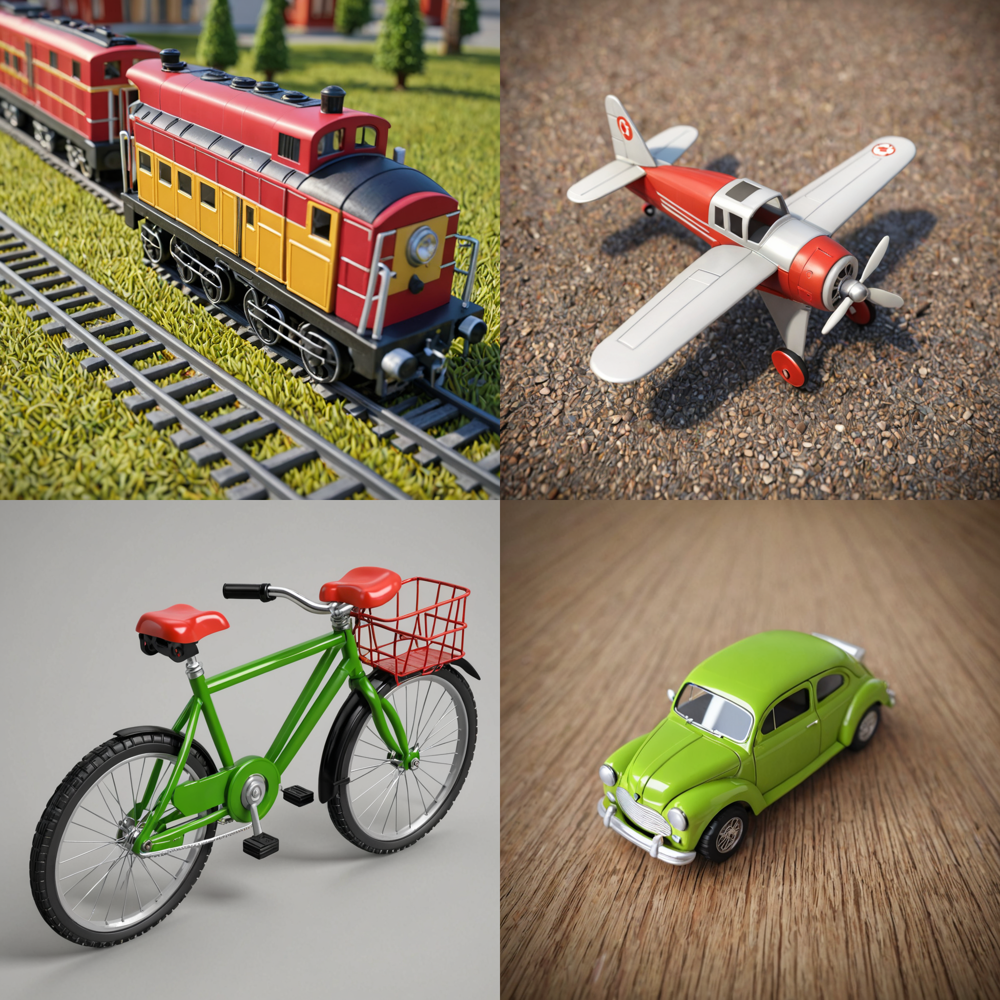

In [9]:
grid = image_grid(images, 2, 2)
grid.save("style-aligned-disabled.png")
grid

In [10]:
pipe.enable_style_aligned(
    share_group_norm=False,
    share_layer_norm=False,
    share_attention=True,
    adain_queries=True,
    adain_keys=True,
    adain_values=False,
    full_attention_share=False,
    shared_score_scale=1.0,
    shared_score_shift=0.0,
    only_self_level=0.0,
)

In [11]:
images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=2,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/10 [00:00<?, ?it/s]

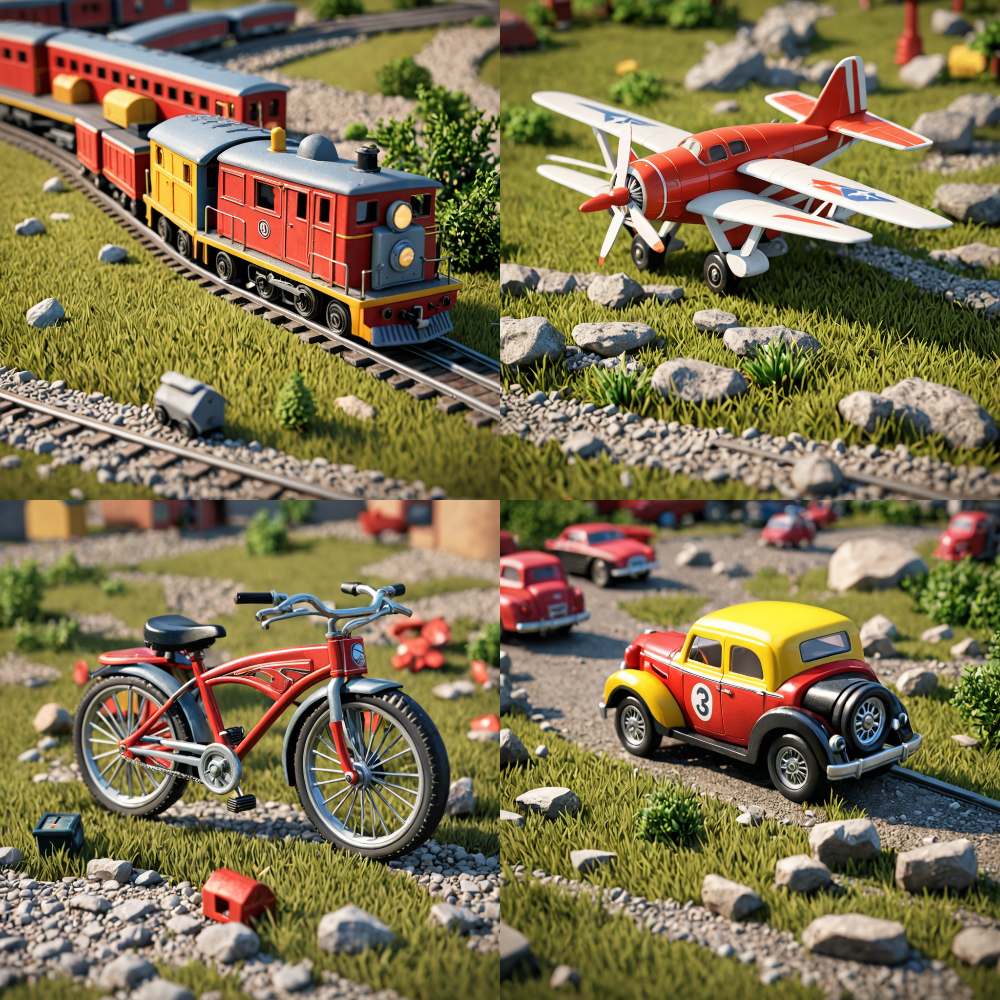

In [12]:
grid = image_grid(images, 2, 2)
grid.save("style-aligned-enabled.png")
grid

In [14]:
pipe.enable_style_aligned(
    share_group_norm=True,
    share_layer_norm=True,
    share_attention=True,
    adain_queries=True,
    adain_keys=True,
    adain_values=False,
    full_attention_share=False,
    shared_score_scale=1.0,
    shared_score_shift=0.0,
    only_self_level=0.0,
)

In [15]:
images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=2,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
grid = image_grid(images, 2, 2)
grid.save("style-aligned-enabled-2.png")
grid

In [24]:
pipe.disable_style_aligned()

In [25]:
images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=2,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
grid = image_grid(images, 2, 2)
grid.save("style-aligned-after-disable.png")
grid

In [ ]:
prompt = {
    "0372.png": "A pretty woman with long hair next to a luminescent bird",
    "0062.png": "A snail moving on the ground",
    "0310.png": "The Space Shuttle Endeavor, flying over the Earth",
    "0737.png": "An astronaut riding a horse in the forest"
}

images = {key: Image.open(key).resize((512, 512)) for key in prompt.keys()}
image_grid(list(images.values()), 2, 2)

In [124]:
pipe.enable_style_aligned(
    share_group_norm=True,
    share_layer_norm=True,
    share_attention=True,
    adain_queries=True,
    adain_keys=True,
    adain_values=True,
    full_attention_share=False,
    shared_score_scale=1.0,
    shared_score_shift=0.0,
    only_self_level=0.0,
)

In [129]:
img2img_images = pipe(
    image=list(images.values()),
    prompt=[f"{p}, paper art, art and craft with paper, real paper art, origami" for p in prompt.values()],
    negative_prompt=negative_prompt,
    strength=0.8,
    guidance_scale=3,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/8 [00:00<?, ?it/s]

In [ ]:
grid = image_grid(img2img_images, 2, 2)
grid.save("style-aligned-enabled-img2img.png")
grid

In [100]:
pipe.enable_style_aligned(
    share_group_norm=False,
    share_layer_norm=False,
    share_attention=True,
    adain_queries=True,
    adain_keys=True,
    adain_values=False,
    full_attention_share=True,
    shared_score_scale=1.0,
    shared_score_shift=0.0,
    only_self_level=0.0,
)

In [101]:
img2img_images = pipe(
    image=list(images.values()),
    prompt=[f"{p}, paper art, art and craft with paper, real paper art, origami" for p in prompt.values()],
    negative_prompt=negative_prompt,
    strength=0.8,
    guidance_scale=2,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/8 [00:00<?, ?it/s]

In [ ]:
grid = image_grid(img2img_images, 2, 2)
grid.save("style-aligned-enabled-img2img-2.png")
grid

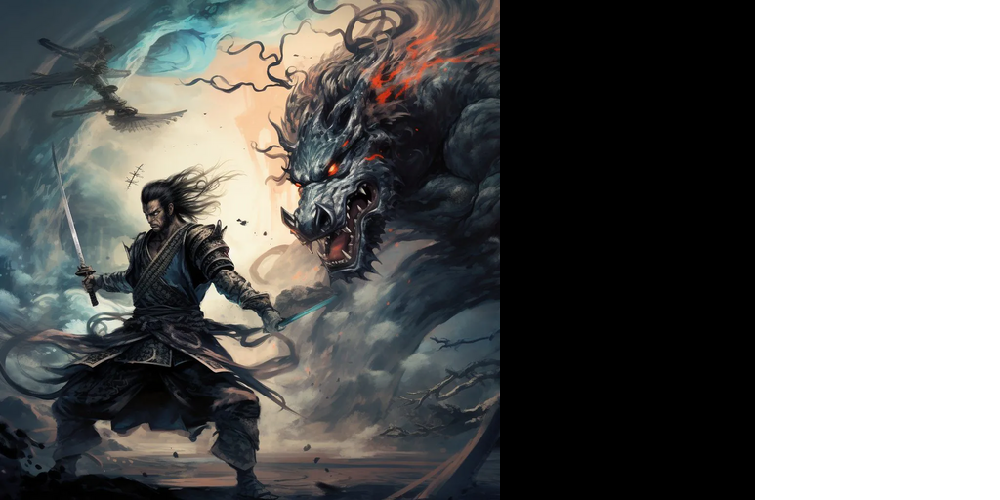

In [97]:
inpaint_image = Image.open("image.png").convert("RGB")
mask_image = Image.open("mask.png").convert("RGB")
image_grid([inpaint_image, mask_image], 1, 2)

In [138]:
if pipe.style_aligned_enabled:
    pipe.disable_style_aligned()

In [143]:
inpaint_images = pipe(
    image=[inpaint_image] * 4,
    mask_image=[mask_image] * 4,
    prompt=[f"an ancient warrior fighting a mystical creature, {x}, photorealistic, high quality" for x in ["biblical", "dragon-like", "alien", "insanity, monstrous"]],
    negative_prompt=negative_prompt,
    strength=0.8,
    guidance_scale=3,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/8 [00:00<?, ?it/s]

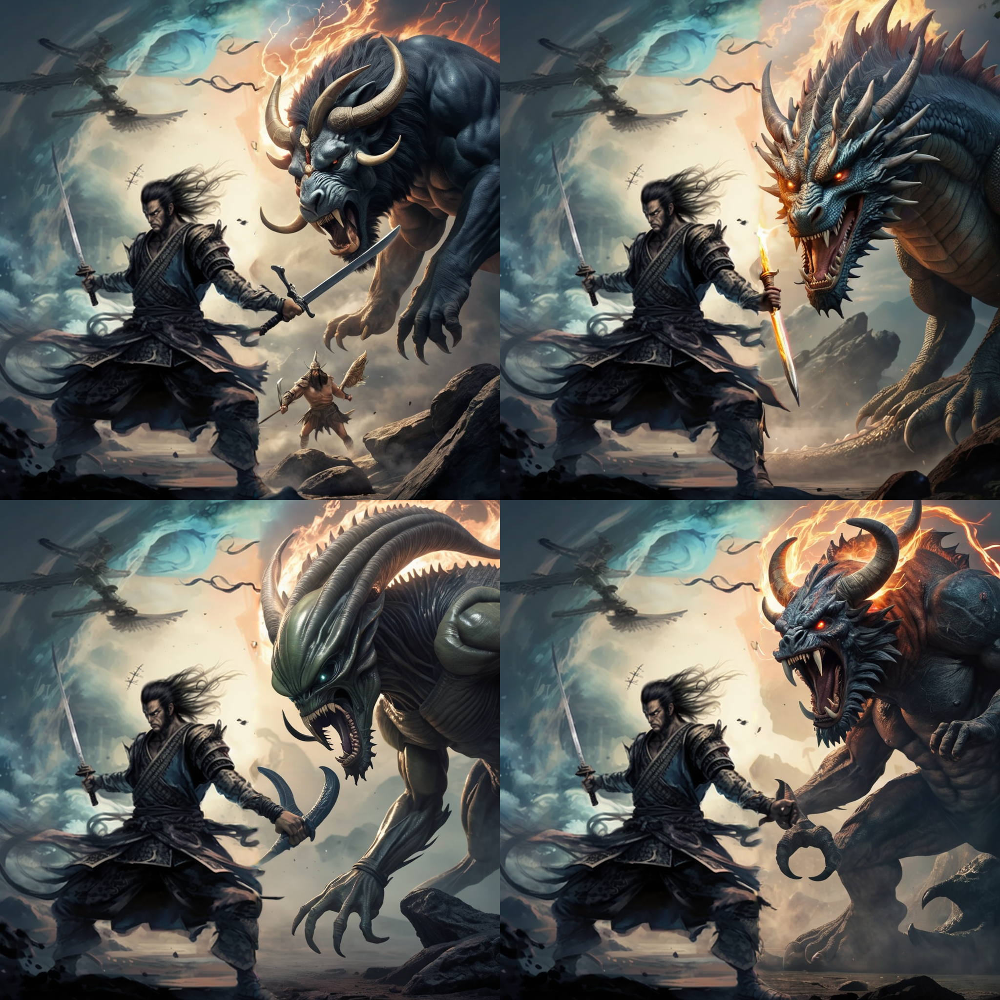

In [144]:
grid = image_grid(inpaint_images, 2, 2)
grid.save("style-aligned-disabled-inpaint.png")
grid

In [151]:
pipe.enable_style_aligned(
    share_group_norm=True,
    share_layer_norm=True,
    share_attention=True,
    adain_queries=True,
    adain_keys=True,
    adain_values=False,
    full_attention_share=False,
    shared_score_scale=1.0,
    shared_score_shift=0.0,
    only_self_level=0.0,
)

In [152]:
inpaint_images = pipe(
    image=[inpaint_image] * 4,
    mask_image=[mask_image] * 4,
    prompt=[f"an ancient warrior fighting a mystical creature, {x}, photorealistic, high quality" for x in ["biblical", "dragon-like", "alien", "insanity, monstrous"]],
    negative_prompt=negative_prompt,
    strength=0.8,
    guidance_scale=3,
    height=1024,
    width=1024,
    num_inference_steps=10,
    generator=torch.Generator().manual_seed(42),
).images

  0%|          | 0/8 [00:00<?, ?it/s]

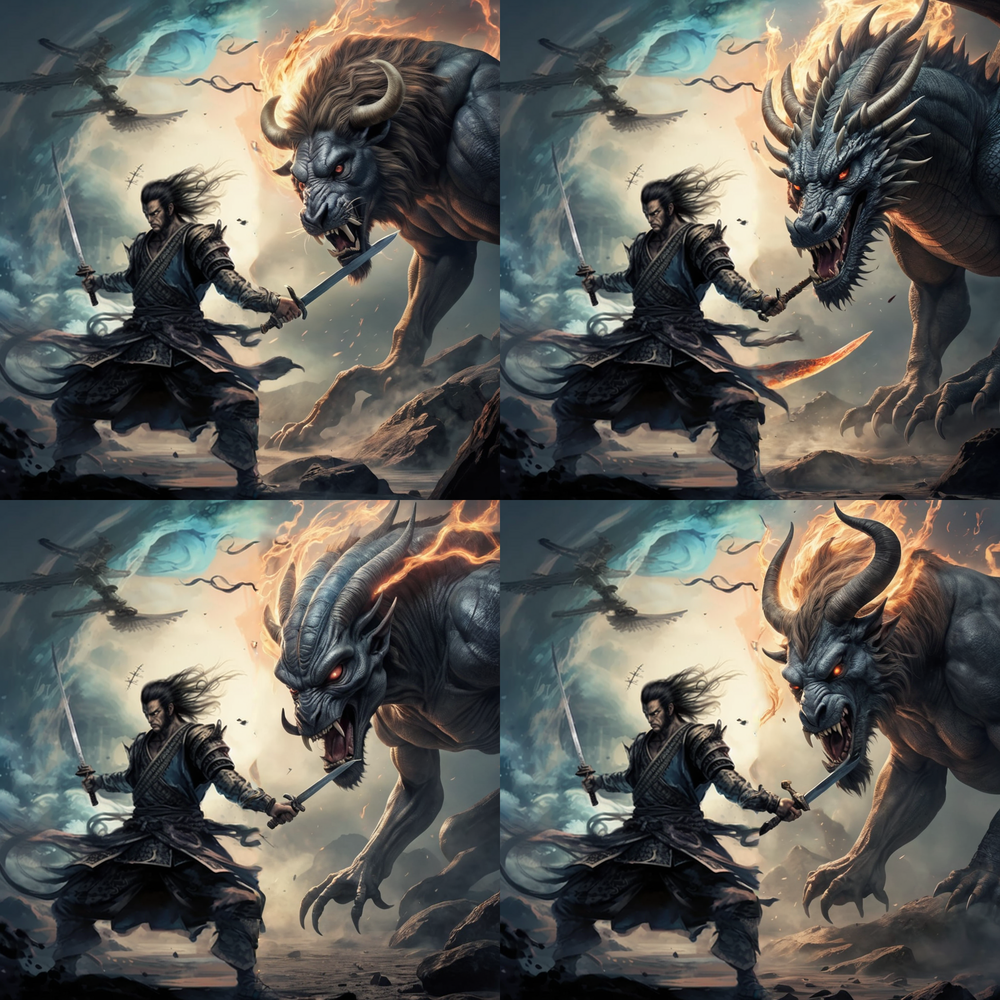

In [153]:
grid = image_grid(inpaint_images, 2, 2)
grid.save("style-aligned-disabled-inpaint-2.png")
grid